# Post-scVI analysis of steady state organoids data & donor P13 in vivo data (SN+multiome)

This is the version of the manifold after running scVI by `donor_sample` and incorporating CCG filtering for both organoids and P13 object and additionally soupy genes in organoids object

06.01.2022

What happens here:
- load preprocessed object (raw filtered)
- do normalising & log transforming
- save raw attribute to then be able to plot all genes on the HVG-subsetted dataset
- calculate neighborhood graph on the latent dimensionality reporesentation from scVI
- umap
- unbiased clustering
- save

In [1]:
%matplotlib inline
%config InlineBackend.figure_format = 'retina'

### for UMAPs that don't look weird please overwrite existing installation of umap-learn with: pip install umap-learn==0.5.1
### version 0.5.2 that is loaded by default yield weird looking umaps!

import numpy as np
import pandas as pd
import seaborn as sns
import scanpy as sc
from glob import iglob
import anndata
import bbknn
import scrublet as scr
import os
import sklearn
from sklearn.linear_model import LogisticRegression
import matplotlib as mpl
import scipy
import matplotlib.pyplot as plt
import pickle

In [2]:
np.random.seed(0)

In [3]:
sc.settings.verbosity = 3  # verbosity: errors (0), warnings (1), info (2), hints (3)
sc.logging.print_versions()
sc.settings.set_figure_params(dpi=80)  # low dpi (dots per inch) yields small inline figures

-----
anndata     0.7.5
scanpy      1.7.1
sinfo       0.3.1
-----
PIL                 8.1.2
anndata             0.7.5
annoy               NA
anyio               NA
attr                20.3.0
babel               2.9.0
backcall            0.2.0
bbknn               NA
brotli              NA
cairo               1.20.0
certifi             2021.10.08
cffi                1.14.5
chardet             4.0.0
cloudpickle         1.6.0
colorama            0.4.4
cycler              0.10.0
cython_runtime      NA
cytoolz             0.11.0
dask                2021.03.1
dateutil            2.8.1
decorator           4.4.2
fsspec              0.8.7
get_version         2.1
google              NA
h5py                3.1.0
idna                2.10
igraph              0.8.3
ipykernel           5.5.0
ipython_genutils    0.2.0
ipywidgets          7.6.3
jedi                0.18.0
jinja2              2.11.3
joblib              1.0.1
json5               NA
jsonschema          3.2.0
jupyter_server      1.4.1
jupyte

In [4]:
save_path = '/lustre/scratch117/cellgen/team292/aa22/adata_objects/202105_troph_organoids_exp_1_2/'

## Reading raw objects to then concatenate them

In [6]:
# specifically the data realigned with pre-mRNA genome

path = '/lustre/scratch117/cellgen/team292/aa22/adata_objects/202105_troph_organoids_exp_1_2/'

# Loading object with raw counts, filtered cells and genes object
# only final cells intersected with those that were filtered through QC of the pre-mRNA aligned data
adata_org = sc.read_h5ad(path + 'adata_raw_filtered_premrna_aligned_for_scVI.h5ad')

In [7]:
adata_org

AnnData object with n_obs × n_vars = 36647 × 33538
    obs: 'n_genes', 'time_point', 'activation_status', 'media', 'sample', 'percent_mito', 'n_counts', 'dataset', 'technique', 'scrublet_score', 'scrublet_cluster_score', 'bh_pval', 'batch', 'is_doublet', 'experiment', 'barcode', 'souporcell_assignment', 'inter_ind_doublet', 'donor', 'prelim_annot_v2', 'S_score', 'G2M_score', 'phase', 'celltype_predictions_P13', 'probabilities_P13', 'celltype_predictions_Roser', 'probabilities_Roser', 'louvain', 'louvain_R', 'barcode_sample_copy', 'prelim_annot_v3', 'final_annot_v4', 'louvain_R_5', 'louvain_R_5,1', 'louvain_R_4', 'louvain_RR_4', 'louvain_final', 'louvain_RR_4_1', 'final_annot_v5', 'final_annot_v6', 'final_annot_v7', 'donor_sample'
    var: 'gene_ids', 'feature_types', 'genome'
    uns: 'activation_status_colors', 'donor_colors', 'experiment_colors', 'media_colors', 'prelim_annot_v3_colors', 'sample_colors', 'time_point_colors'
    obsm: 'X_pca', 'X_scVI_n_latent_10_donor_sample_gf_v3', 

In [8]:
# reading donor P13 dataset
path_P13 = '/lustre/scratch117/cellgen/team292/aa22/adata_objects/202007_snRNA-seq_MFI/snRNA_seq_MFI_202007_adatas/202012_FINAL_reanalysis_with_souporcell_deconvolution_common_variants/donor_P13_all_samples_analysis_202110/'
# raw matrix in .X
adata_P13 = sc.read(path_P13 + 'adata_raw_filtered.h5ad')
adata_with_annotation = sc.read(path_P13 + 'adata_P13_scVI_analysed_corr_by_sample_SN_and_multiome_trophoblast_v5_final.h5ad')

# subset to final nuclei and transfer final annotations
adata_P13 = adata_P13[adata_with_annotation.obs_names,:]
adata_P13.obs['cell_type'] = adata_with_annotation.obs.loc[adata_P13.obs_names, 'final_annot_all_troph']


/opt/conda/lib/python3.8/site-packages/pandas/core/arrays/categorical.py:2487: FutureWarning: The `inplace` parameter in pandas.Categorical.remove_unused_categories is deprecated and will be removed in a future version.
  res = method(*args, **kwargs)
Trying to set attribute `.obs` of view, copying.


In [9]:
for col in adata_with_annotation.obs.columns:
    print(col)
    adata_P13.obs[col] = adata_with_annotation.obs.loc[adata_P13.obs_names,col]
adata_P13.obs['cell_type'] = adata_with_annotation.obs.loc[adata_P13.obs_names, 'final_annot_all_troph']


n_genes
donor
tissue_block
age
sample
percent_mito
n_counts
dataset
technique
scrublet_score
scrublet_cluster_score
bh_pval
batch
is_doublet
barcode_sample_copy
barcode
souporcell_assignment
inter_ind_doublet
S_score
G2M_score
phase
annotation_prev
louvain
is_doublet_propagate
origin_M_F
annotation_prev_or_removed
inv_troph_labels_initial
louvain_scvi_n_latent_8
final_annot_inv_troph
louvain_scvi_troph_rest
final_annot_all_troph
final_annot_inv_troph_corrected
final_annot_all_troph_corrected


In [10]:
adata_P13

AnnData object with n_obs × n_vars = 37675 × 29058
    obs: 'n_genes', 'donor', 'tissue_block', 'age', 'sample', 'percent_mito', 'n_counts', 'dataset', 'technique', 'scrublet_score', 'scrublet_cluster_score', 'bh_pval', 'batch', 'is_doublet', 'cell_type', 'barcode_sample_copy', 'barcode', 'souporcell_assignment', 'inter_ind_doublet', 'S_score', 'G2M_score', 'phase', 'annotation_prev', 'louvain', 'is_doublet_propagate', 'origin_M_F', 'annotation_prev_or_removed', 'inv_troph_labels_initial', 'louvain_scvi_n_latent_8', 'final_annot_inv_troph', 'louvain_scvi_troph_rest', 'final_annot_all_troph', 'final_annot_inv_troph_corrected', 'final_annot_all_troph_corrected'
    var: 'gene_ids-0', 'feature_types-0', 'genome-0', 'n_cells-0', 'gene_ids-1', 'feature_types-1', 'genome-1', 'n_cells-1', 'gene_ids-2', 'feature_types-2', 'genome-2', 'n_cells-2', 'gene_ids-3', 'feature_types-3', 'genome-3', 'n_cells-3', 'gene_ids-4', 'feature_types-4', 'genome-4', 'n_cells-4', 'gene_ids-5', 'feature_types-5', 

In [11]:
# concatenate into 1 joint raw object
adata = anndata.concat([adata_org, adata_P13], join='outer')

/opt/conda/lib/python3.8/site-packages/anndata/_core/merge.py:891: UserWarning: Only some AnnData objects have `.raw` attribute, not concatenating `.raw` attributes.
  warn(


In [12]:
adata

AnnData object with n_obs × n_vars = 74322 × 33538
    obs: 'n_genes', 'time_point', 'activation_status', 'media', 'sample', 'percent_mito', 'n_counts', 'dataset', 'technique', 'scrublet_score', 'scrublet_cluster_score', 'bh_pval', 'batch', 'is_doublet', 'experiment', 'barcode', 'souporcell_assignment', 'inter_ind_doublet', 'donor', 'prelim_annot_v2', 'S_score', 'G2M_score', 'phase', 'celltype_predictions_P13', 'probabilities_P13', 'celltype_predictions_Roser', 'probabilities_Roser', 'louvain', 'louvain_R', 'barcode_sample_copy', 'prelim_annot_v3', 'final_annot_v4', 'louvain_R_5', 'louvain_R_5,1', 'louvain_R_4', 'louvain_RR_4', 'louvain_final', 'louvain_RR_4_1', 'final_annot_v5', 'final_annot_v6', 'final_annot_v7', 'donor_sample', 'tissue_block', 'age', 'cell_type', 'annotation_prev', 'is_doublet_propagate', 'origin_M_F', 'annotation_prev_or_removed', 'inv_troph_labels_initial', 'louvain_scvi_n_latent_8', 'final_annot_inv_troph', 'louvain_scvi_troph_rest', 'final_annot_all_troph', 'fin

In [13]:
np.unique(adata.obs['sample'])

array(['6044STDY8640561', '6044STDY8640563', '6044STDY8640565',
       'Pla_Camb10123928', 'Pla_Camb10123929', 'Pla_Camb10123930',
       'Pla_Camb10123932', 'Pla_Camb10123934', 'Pla_Camb10691970',
       'Pla_Camb10691971', 'Pla_Camb10714919_and_40110_Pla_Camb10687915',
       'Pla_Camb10714920_and_40110_Pla_Camb10687916', 'WSSS_PLA8764121',
       'WSSS_PLA8764122', 'WSSS_PLA8810750', 'WSSS_PLA8810751'],
      dtype=object)

In [14]:
np.unique(adata.obs['donor'])

array(['1', '2', '3', '4', '5', '6', 'P13'], dtype=object)

In [15]:
# quick check to see if raw is raw or not
expr_mtx_dense = adata[adata.obs['sample'] == 'Pla_Camb10691970'].X.todense()

In [16]:
# YAS we all good
np.unique(expr_mtx_dense)

matrix([[   0.,    0.,    0., ..., 1932., 2055., 3312.]], dtype=float32)

________

Carrying on to 
- Normalise and log transform
- Save raw attribute to then be able to plot all genes on the HVG-subsetted dataset
- Make cell names (obs) and gene names (var) unique

In [17]:
# normalise and log transform
sc.pp.normalize_per_cell(adata, counts_per_cell_after=1e4)
sc.pp.log1p(adata)

# saving normalised and log transformed values into the raw attribute to later be able to plot
adata.raw = adata.copy()

adata.var_names_make_unique()
adata.obs_names_make_unique()

normalizing by total count per cell
    finished (0:00:03): normalized adata.X and added    'n_counts', counts per cell before normalization (adata.obs)


_____________________________________________________________________________________________________________________________________________________________

In [18]:
# Assign cell cycle stage & scores
cell_cycle_genes = [x.strip() for x in open(file='/home/jovyan/notebooks/Vento_Lab/regev_lab_cell_cycle_genes_from_Luz_20200505.txt')]
s_genes = cell_cycle_genes[:43]
g2m_genes = cell_cycle_genes[43:]
s_genes = [x for x in s_genes if x in adata.var_names]
g2m_genes = [x for x in g2m_genes if x in adata.var_names]
sc.tl.score_genes_cell_cycle(adata, s_genes=s_genes, g2m_genes=g2m_genes)

calculating cell cycle phase
computing score 'S_score'
    finished: added
    'S_score', score of gene set (adata.obs).
    501 total control genes are used. (0:00:04)
computing score 'G2M_score'
    finished: added
    'G2M_score', score of gene set (adata.obs).
    374 total control genes are used. (0:00:04)
-->     'phase', cell cycle phase (adata.obs)


In [19]:
adata

AnnData object with n_obs × n_vars = 74322 × 33538
    obs: 'n_genes', 'time_point', 'activation_status', 'media', 'sample', 'percent_mito', 'n_counts', 'dataset', 'technique', 'scrublet_score', 'scrublet_cluster_score', 'bh_pval', 'batch', 'is_doublet', 'experiment', 'barcode', 'souporcell_assignment', 'inter_ind_doublet', 'donor', 'prelim_annot_v2', 'S_score', 'G2M_score', 'phase', 'celltype_predictions_P13', 'probabilities_P13', 'celltype_predictions_Roser', 'probabilities_Roser', 'louvain', 'louvain_R', 'barcode_sample_copy', 'prelim_annot_v3', 'final_annot_v4', 'louvain_R_5', 'louvain_R_5,1', 'louvain_R_4', 'louvain_RR_4', 'louvain_final', 'louvain_RR_4_1', 'final_annot_v5', 'final_annot_v6', 'final_annot_v7', 'donor_sample', 'tissue_block', 'age', 'cell_type', 'annotation_prev', 'is_doublet_propagate', 'origin_M_F', 'annotation_prev_or_removed', 'inv_troph_labels_initial', 'louvain_scvi_n_latent_8', 'final_annot_inv_troph', 'louvain_scvi_troph_rest', 'final_annot_all_troph', 'fin

_______________________________________________________________________________________________________

# Read in scVI-calculated latent representation

In [20]:
# a few values
n_latent = [5, 10, 15, 20, 30, 40]

### 06.01.2022 run, correction by `donor_sample`

In [21]:
latent_representations_donor = {}

# didn't align as well as corrected by donor_sample

for n_latent_value in n_latent:
    print(n_latent_value)
        
    curr_path = '/nfs/team292/aa22/scVI_related/202105_troph_organoids/20220106_obsm_with_scVI_latent_representation_n_' + str(n_latent_value) + '_steady_state_organoids_after_ccg_removal_and_LF_gf_and_donor_P13_after_ccg_removal.csv' 
        
    latent_representations_donor[n_latent_value] = pd.read_csv(curr_path, index_col=0)

5
10
15
20
30
40


In [22]:
# assign these latent_representations into adata.obsm
for n_latent_value in n_latent:
    print(n_latent_value)
    adata.obsm['X_scVI_n_latent_' + str(n_latent_value) + '_donor_sample'] = np.array(latent_representations_donor[n_latent_value])

5
10
15
20
30
40


In [23]:
adata.obsm['X_scVI_n_latent_5_donor_sample'].shape

(74322, 5)

__________________________________________________________________________________________________________________________________________________________________

### Neighbourhood graph & UMAP

In [24]:
%%time

for n_latent_value in n_latent:
    print(n_latent_value)
    sc.pp.neighbors(adata, n_neighbors=10, use_rep='X_scVI_n_latent_' + str(n_latent_value) + '_donor_sample',
               key_added='neighbors_scVI_n_latent_' + str(n_latent_value) + '_donor_sample' )

computing neighbors


5


    finished: added to `.uns['neighbors_scVI_n_latent_5_donor_sample']`
    `.obsp['neighbors_scVI_n_latent_5_donor_sample_distances']`, distances for each pair of neighbors
    `.obsp['neighbors_scVI_n_latent_5_donor_sample_connectivities']`, weighted adjacency matrix (0:00:20)
computing neighbors


10


    finished: added to `.uns['neighbors_scVI_n_latent_10_donor_sample']`
    `.obsp['neighbors_scVI_n_latent_10_donor_sample_distances']`, distances for each pair of neighbors
    `.obsp['neighbors_scVI_n_latent_10_donor_sample_connectivities']`, weighted adjacency matrix (0:00:08)
computing neighbors


15


    finished: added to `.uns['neighbors_scVI_n_latent_15_donor_sample']`
    `.obsp['neighbors_scVI_n_latent_15_donor_sample_distances']`, distances for each pair of neighbors
    `.obsp['neighbors_scVI_n_latent_15_donor_sample_connectivities']`, weighted adjacency matrix (0:00:08)
computing neighbors


20


    finished: added to `.uns['neighbors_scVI_n_latent_20_donor_sample']`
    `.obsp['neighbors_scVI_n_latent_20_donor_sample_distances']`, distances for each pair of neighbors
    `.obsp['neighbors_scVI_n_latent_20_donor_sample_connectivities']`, weighted adjacency matrix (0:00:06)
computing neighbors


30


    finished: added to `.uns['neighbors_scVI_n_latent_30_donor_sample']`
    `.obsp['neighbors_scVI_n_latent_30_donor_sample_distances']`, distances for each pair of neighbors
    `.obsp['neighbors_scVI_n_latent_30_donor_sample_connectivities']`, weighted adjacency matrix (0:00:08)
computing neighbors


40


    finished: added to `.uns['neighbors_scVI_n_latent_40_donor_sample']`
    `.obsp['neighbors_scVI_n_latent_40_donor_sample_distances']`, distances for each pair of neighbors
    `.obsp['neighbors_scVI_n_latent_40_donor_sample_connectivities']`, weighted adjacency matrix (0:00:08)


CPU times: user 3min 9s, sys: 3min 29s, total: 6min 39s
Wall time: 1min 1s


In [25]:
adata

AnnData object with n_obs × n_vars = 74322 × 33538
    obs: 'n_genes', 'time_point', 'activation_status', 'media', 'sample', 'percent_mito', 'n_counts', 'dataset', 'technique', 'scrublet_score', 'scrublet_cluster_score', 'bh_pval', 'batch', 'is_doublet', 'experiment', 'barcode', 'souporcell_assignment', 'inter_ind_doublet', 'donor', 'prelim_annot_v2', 'S_score', 'G2M_score', 'phase', 'celltype_predictions_P13', 'probabilities_P13', 'celltype_predictions_Roser', 'probabilities_Roser', 'louvain', 'louvain_R', 'barcode_sample_copy', 'prelim_annot_v3', 'final_annot_v4', 'louvain_R_5', 'louvain_R_5,1', 'louvain_R_4', 'louvain_RR_4', 'louvain_final', 'louvain_RR_4_1', 'final_annot_v5', 'final_annot_v6', 'final_annot_v7', 'donor_sample', 'tissue_block', 'age', 'cell_type', 'annotation_prev', 'is_doublet_propagate', 'origin_M_F', 'annotation_prev_or_removed', 'inv_troph_labels_initial', 'louvain_scvi_n_latent_8', 'final_annot_inv_troph', 'louvain_scvi_troph_rest', 'final_annot_all_troph', 'fin

__________________________________________________________________________________________________________________________________________________________________

In [26]:
%%time

for n_latent_value in n_latent:
    print(n_latent_value)

    sc.tl.umap(adata, random_state=0,
              neighbors_key='neighbors_scVI_n_latent_' + str(n_latent_value) + '_donor_sample')
    # copy current adata.obsm['X_umap'] into adata.obsm['X_umap_scVI_n_latent_' + str(n_latent_value)]
    adata.obsm['X_umap_scVI_n_latent_' + str(n_latent_value) + '_donor_sample'] = adata.obsm['X_umap']
    
    

computing UMAP


5


    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:00:52)
computing UMAP


10


    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:00:58)
computing UMAP


15


    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:00:58)
computing UMAP


20


    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:01:09)
computing UMAP


30


    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:01:01)
computing UMAP


40


    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:01:03)


CPU times: user 15min 6s, sys: 11min 21s, total: 26min 27s
Wall time: 6min 5s


In [27]:
# add latest predictions from donor P13 dataset
predictions_probs_df = pd.read_csv(save_path + '20220105_predictions_probs_df_premrna.csv', index_col=0)
predictions_probs_df.columns

Index(['probabilities_P13_premrna_gf_downsampled_HVGs_fine_annot',
       'celltype_predictions_P13_premrna_gf_downsampled_HVGs_fine_annot',
       'probabilities_P13_premrna_downsampled_HVGs_fine_annot',
       'celltype_predictions_P13_premrna_downsampled_HVGs_fine_annot'],
      dtype='object')

In [28]:
adata.obs['celltype_predictions_P13'] = [predictions_probs_df.loc[idx, 'celltype_predictions_P13_premrna_downsampled_HVGs_fine_annot'] if idx in predictions_probs_df.index else 'na' for idx in adata.obs_names]
adata.obs['probabilities_P13'] = [predictions_probs_df.loc[idx, 'probabilities_P13_premrna_downsampled_HVGs_fine_annot'] if idx in predictions_probs_df.index else 0 for idx in adata.obs_names]


In [29]:
adata.obs['celltype_predictions_P13'].value_counts()

na            37675
VCT_CCC        9276
EVT_1          4980
EVT_2          4901
VCT            4765
VCT_fusing     4012
iEVT           3908
GC             2323
SCT            2214
eEVT            268
Name: celltype_predictions_P13, dtype: int64

In [30]:
np.unique(adata.obs['sample'], return_counts=True)

(array(['6044STDY8640561', '6044STDY8640563', '6044STDY8640565',
        'Pla_Camb10123928', 'Pla_Camb10123929', 'Pla_Camb10123930',
        'Pla_Camb10123932', 'Pla_Camb10123934', 'Pla_Camb10691970',
        'Pla_Camb10691971', 'Pla_Camb10714919_and_40110_Pla_Camb10687915',
        'Pla_Camb10714920_and_40110_Pla_Camb10687916', 'WSSS_PLA8764121',
        'WSSS_PLA8764122', 'WSSS_PLA8810750', 'WSSS_PLA8810751'],
       dtype=object),
 array([4845, 7713, 6021, 2658, 4762, 2950, 1291, 6407, 3942, 3742, 3075,
        3103, 3165, 3145, 9337, 8166]))

In [31]:
adata

AnnData object with n_obs × n_vars = 74322 × 33538
    obs: 'n_genes', 'time_point', 'activation_status', 'media', 'sample', 'percent_mito', 'n_counts', 'dataset', 'technique', 'scrublet_score', 'scrublet_cluster_score', 'bh_pval', 'batch', 'is_doublet', 'experiment', 'barcode', 'souporcell_assignment', 'inter_ind_doublet', 'donor', 'prelim_annot_v2', 'S_score', 'G2M_score', 'phase', 'celltype_predictions_P13', 'probabilities_P13', 'celltype_predictions_Roser', 'probabilities_Roser', 'louvain', 'louvain_R', 'barcode_sample_copy', 'prelim_annot_v3', 'final_annot_v4', 'louvain_R_5', 'louvain_R_5,1', 'louvain_R_4', 'louvain_RR_4', 'louvain_final', 'louvain_RR_4_1', 'final_annot_v5', 'final_annot_v6', 'final_annot_v7', 'donor_sample', 'tissue_block', 'age', 'cell_type', 'annotation_prev', 'is_doublet_propagate', 'origin_M_F', 'annotation_prev_or_removed', 'inv_troph_labels_initial', 'louvain_scvi_n_latent_8', 'final_annot_inv_troph', 'louvain_scvi_troph_rest', 'final_annot_all_troph', 'fin

## Saving this object with all the manifolds calculated

In [32]:
adata.write(save_path + 'adata_nonact_organoids_and_P13_sn_multiome_scVI_analysed_corr_by_donor_sample.h5ad')


... storing 'time_point' as categorical
... storing 'activation_status' as categorical
... storing 'media' as categorical
... storing 'sample' as categorical
... storing 'dataset' as categorical
... storing 'batch' as categorical
... storing 'experiment' as categorical
... storing 'souporcell_assignment' as categorical
... storing 'donor' as categorical
... storing 'prelim_annot_v2' as categorical
... storing 'phase' as categorical
... storing 'celltype_predictions_P13' as categorical
... storing 'celltype_predictions_Roser' as categorical
... storing 'louvain' as categorical
... storing 'louvain_R' as categorical
... storing 'prelim_annot_v3' as categorical
... storing 'final_annot_v4' as categorical
... storing 'louvain_R_5' as categorical
... storing 'louvain_R_5,1' as categorical
... storing 'louvain_R_4' as categorical
... storing 'louvain_RR_4' as categorical
... storing 'louvain_final' as categorical
... storing 'louvain_RR_4_1' as categorical
... storing 'final_annot_v5' as cat

In [5]:
# reading the previously saved file
# this is a common file with all scVI runs' manifold (corr by donor_sample OR dataset OR donor, not only corr by donor_sample like the name suggests)
adata = sc.read(save_path + 'adata_nonact_organoids_and_P13_sn_multiome_scVI_analysed_corr_by_donor_sample.h5ad')


In [44]:
adata.obs.columns

Index(['n_genes', 'time_point', 'activation_status', 'media', 'sample',
       'percent_mito', 'n_counts', 'dataset', 'technique', 'scrublet_score',
       'scrublet_cluster_score', 'bh_pval', 'batch', 'is_doublet',
       'experiment', 'barcode', 'souporcell_assignment', 'inter_ind_doublet',
       'donor', 'prelim_annot_v2', 'S_score', 'G2M_score', 'phase',
       'celltype_predictions_P13', 'probabilities_P13',
       'celltype_predictions_Roser', 'probabilities_Roser', 'louvain',
       'louvain_R', 'barcode_sample_copy', 'prelim_annot_v3', 'final_annot_v4',
       'louvain_R_5', 'louvain_R_5,1', 'louvain_R_4', 'louvain_RR_4',
       'louvain_final', 'louvain_RR_4_1', 'final_annot_v5', 'final_annot_v6',
       'final_annot_v7', 'donor_sample', 'tissue_block', 'age', 'cell_type',
       'annotation_prev', 'is_doublet_propagate', 'origin_M_F',
       'annotation_prev_or_removed', 'inv_troph_labels_initial',
       'louvain_scvi_n_latent_8', 'final_annot_inv_troph',
       'louvain_sc

In [33]:
adata.obs['dataset'] = ['P13_in_vivo' if donor == 'P13' else 'in_vitro_orgs' for donor in adata.obs['donor']]
adata.obs['dataset'].value_counts()

P13_in_vivo      37675
in_vitro_orgs    36647
Name: dataset, dtype: int64

### scVI-corrected by `donor_sample`

n_latent = 5

In [6]:
curr_embedding_key = 'X_umap_scVI_n_latent_5_donor_sample'

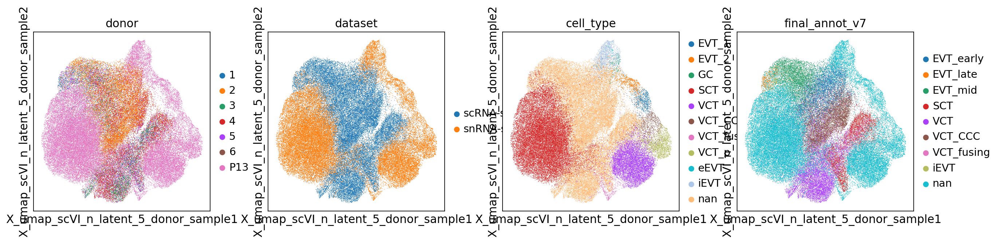

In [7]:
sc.pl.embedding(adata, curr_embedding_key,
                color=['donor','dataset','cell_type','final_annot_v7'])

In [9]:
adata.uns['cell_type_colors'] = ['#1f77b4',
 '#ff7f0e',
 '#279e68',
 '#d62728',
 '#aa40fc',
 '#8c564b',
 '#e377c2',
 '#b5bd61',
 '#17becf',
 '#aec7e8',
 'lightgrey']

In [11]:
adata.uns['final_annot_v7_colors'] = ['#1f77b4',
 '#ff7f0e',
 '#279e68',
 '#d62728',
 '#aa40fc',
 '#8c564b',
 '#e377c2',
 '#b5bd61',
 'lightgrey']

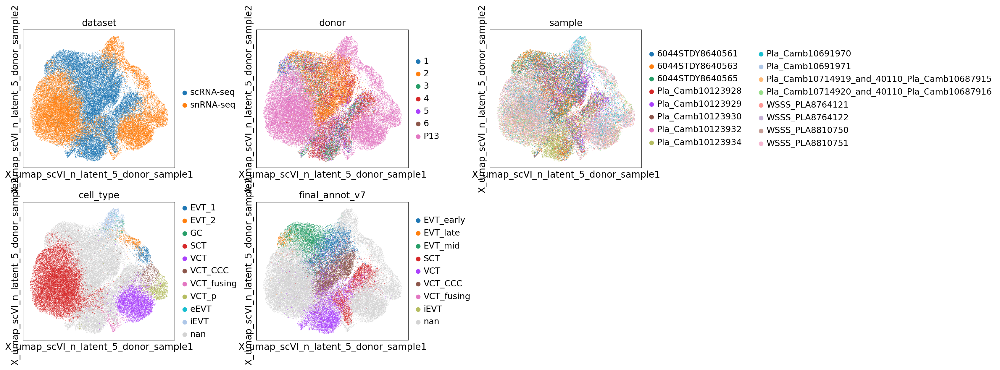

In [13]:
sc.pl.embedding(adata, curr_embedding_key,
                color=['dataset','donor','sample','cell_type','final_annot_v7'], ncols=3,
                wspace=0.4)

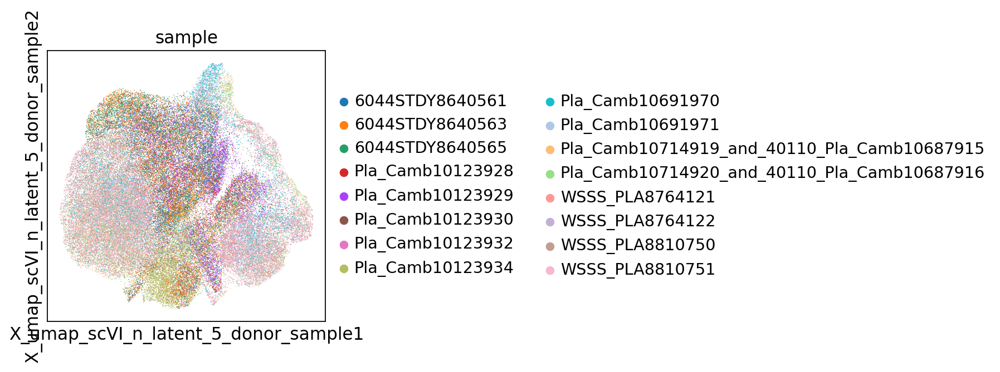

In [36]:
sc.pl.embedding(adata, curr_embedding_key,
                color=['sample'])

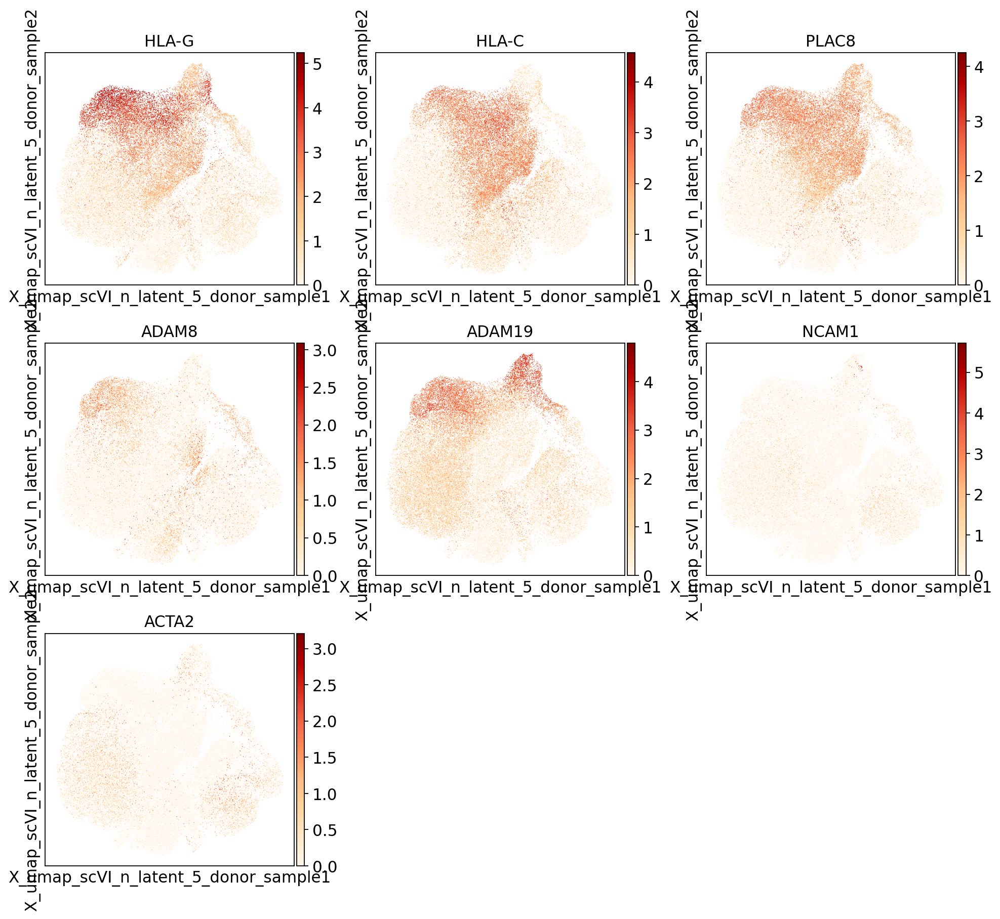

In [37]:
sc.pl.embedding(adata, curr_embedding_key,
                color=['HLA-G','HLA-C','PLAC8',
                             'ADAM8','ADAM19',
                            'NCAM1','ACTA2'], ncols=3, use_raw=True, cmap='OrRd')

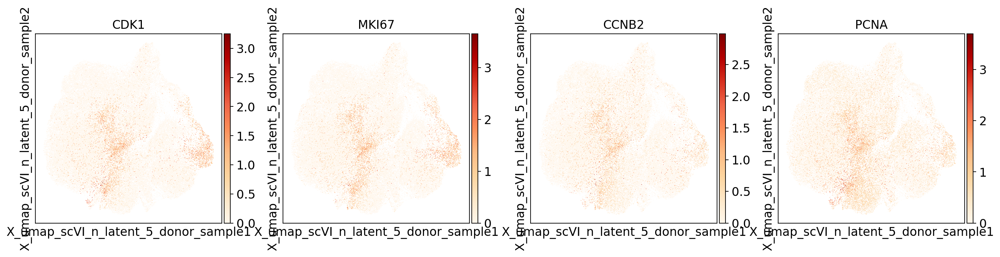

In [38]:
sc.pl.embedding(adata, curr_embedding_key, color=['CDK1','MKI67','CCNB2','PCNA'], cmap='OrRd')

In [39]:
adata

AnnData object with n_obs × n_vars = 74322 × 33538
    obs: 'n_genes', 'time_point', 'activation_status', 'media', 'sample', 'percent_mito', 'n_counts', 'dataset', 'technique', 'scrublet_score', 'scrublet_cluster_score', 'bh_pval', 'batch', 'is_doublet', 'experiment', 'barcode', 'souporcell_assignment', 'inter_ind_doublet', 'donor', 'prelim_annot_v2', 'S_score', 'G2M_score', 'phase', 'celltype_predictions_P13', 'probabilities_P13', 'celltype_predictions_Roser', 'probabilities_Roser', 'louvain', 'louvain_R', 'barcode_sample_copy', 'prelim_annot_v3', 'final_annot_v4', 'louvain_R_5', 'louvain_R_5,1', 'louvain_R_4', 'louvain_RR_4', 'louvain_final', 'louvain_RR_4_1', 'final_annot_v5', 'final_annot_v6', 'final_annot_v7', 'donor_sample', 'tissue_block', 'age', 'cell_type', 'annotation_prev', 'is_doublet_propagate', 'origin_M_F', 'annotation_prev_or_removed', 'inv_troph_labels_initial', 'louvain_scvi_n_latent_8', 'final_annot_inv_troph', 'louvain_scvi_troph_rest', 'final_annot_all_troph', 'fin

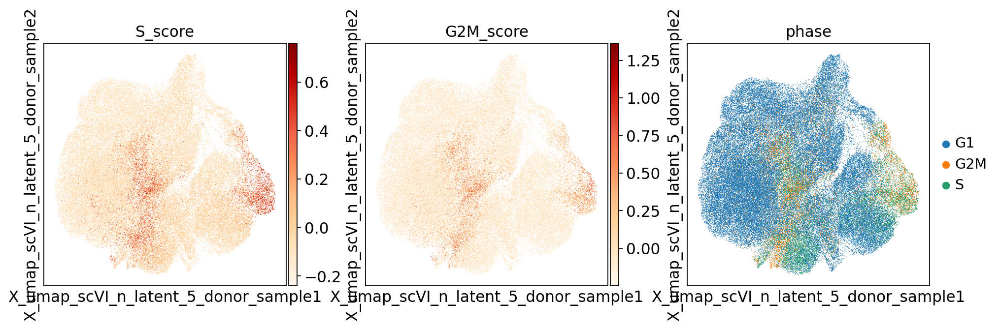

In [40]:
sc.pl.embedding(adata, curr_embedding_key,
                color=['S_score','G2M_score','phase'], cmap='OrRd')

In [41]:
adata

AnnData object with n_obs × n_vars = 74322 × 33538
    obs: 'n_genes', 'time_point', 'activation_status', 'media', 'sample', 'percent_mito', 'n_counts', 'dataset', 'technique', 'scrublet_score', 'scrublet_cluster_score', 'bh_pval', 'batch', 'is_doublet', 'experiment', 'barcode', 'souporcell_assignment', 'inter_ind_doublet', 'donor', 'prelim_annot_v2', 'S_score', 'G2M_score', 'phase', 'celltype_predictions_P13', 'probabilities_P13', 'celltype_predictions_Roser', 'probabilities_Roser', 'louvain', 'louvain_R', 'barcode_sample_copy', 'prelim_annot_v3', 'final_annot_v4', 'louvain_R_5', 'louvain_R_5,1', 'louvain_R_4', 'louvain_RR_4', 'louvain_final', 'louvain_RR_4_1', 'final_annot_v5', 'final_annot_v6', 'final_annot_v7', 'donor_sample', 'tissue_block', 'age', 'cell_type', 'annotation_prev', 'is_doublet_propagate', 'origin_M_F', 'annotation_prev_or_removed', 'inv_troph_labels_initial', 'louvain_scvi_n_latent_8', 'final_annot_inv_troph', 'louvain_scvi_troph_rest', 'final_annot_all_troph', 'fin

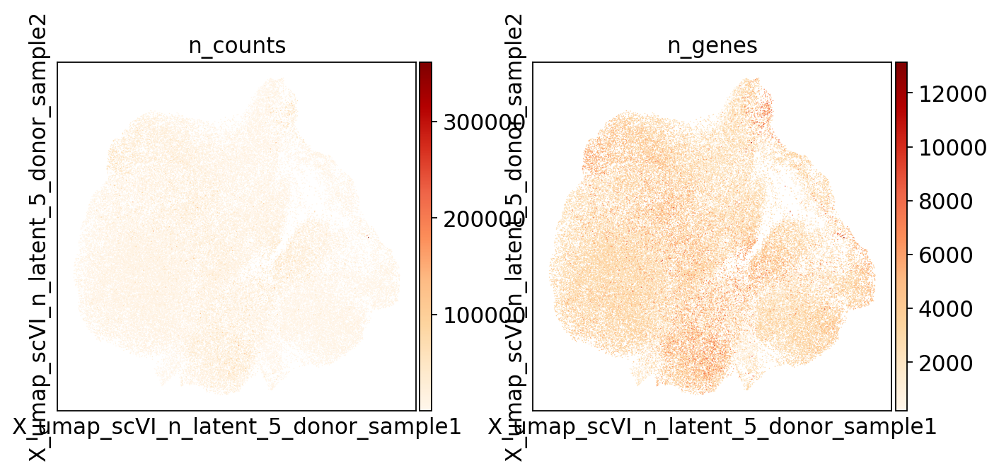

In [42]:
sc.pl.embedding(adata, curr_embedding_key, color=['n_counts',
                             'n_genes'], cmap='OrRd')

### scVI-corrected by `donor_sample`

n_latent = 10

In [43]:
curr_embedding_key = 'X_umap_scVI_n_latent_10_donor_sample'

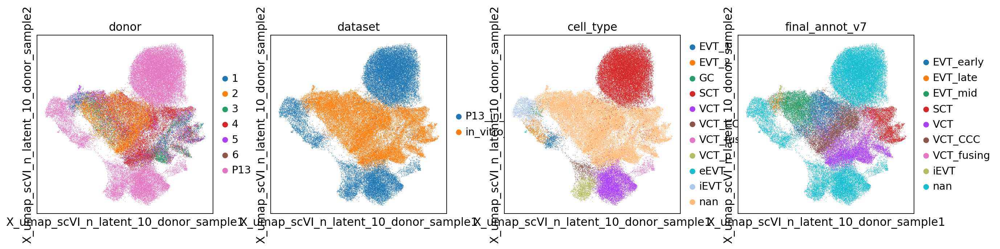

In [44]:
sc.pl.embedding(adata, curr_embedding_key,
                color=['donor','dataset','cell_type','final_annot_v7'])

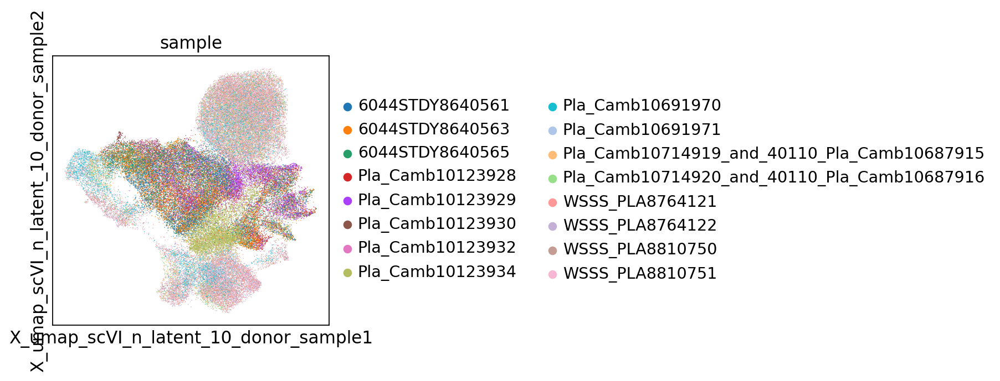

In [45]:
sc.pl.embedding(adata, curr_embedding_key,
                color=['sample'])

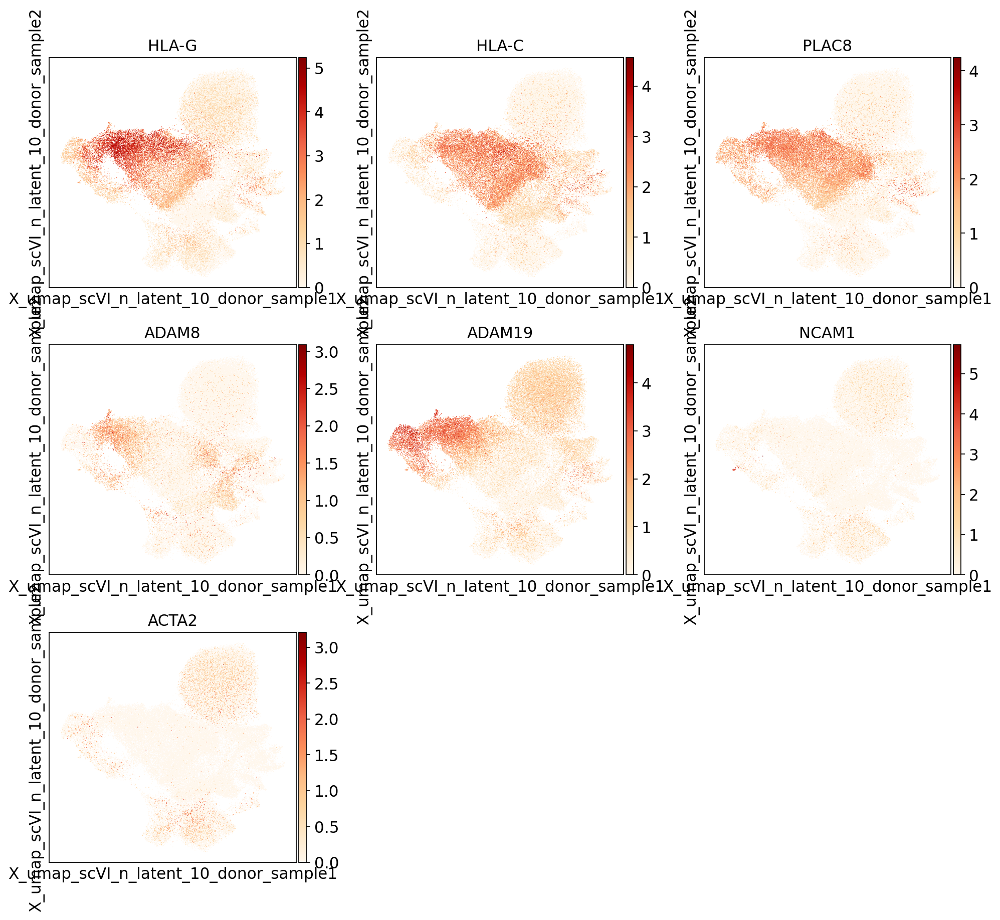

In [46]:
sc.pl.embedding(adata, curr_embedding_key,
                color=['HLA-G','HLA-C','PLAC8',
                             'ADAM8','ADAM19',
                            'NCAM1','ACTA2'], ncols=3, use_raw=True, cmap='OrRd')

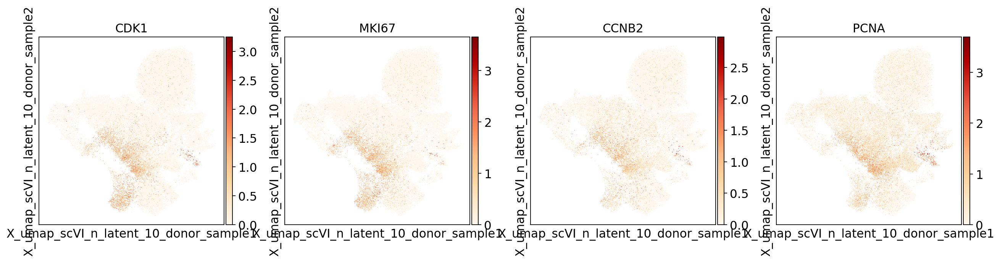

In [47]:
sc.pl.embedding(adata, curr_embedding_key, color=['CDK1','MKI67','CCNB2','PCNA'], cmap='OrRd')

In [48]:
adata

AnnData object with n_obs × n_vars = 74322 × 33538
    obs: 'n_genes', 'time_point', 'activation_status', 'media', 'sample', 'percent_mito', 'n_counts', 'dataset', 'technique', 'scrublet_score', 'scrublet_cluster_score', 'bh_pval', 'batch', 'is_doublet', 'experiment', 'barcode', 'souporcell_assignment', 'inter_ind_doublet', 'donor', 'prelim_annot_v2', 'S_score', 'G2M_score', 'phase', 'celltype_predictions_P13', 'probabilities_P13', 'celltype_predictions_Roser', 'probabilities_Roser', 'louvain', 'louvain_R', 'barcode_sample_copy', 'prelim_annot_v3', 'final_annot_v4', 'louvain_R_5', 'louvain_R_5,1', 'louvain_R_4', 'louvain_RR_4', 'louvain_final', 'louvain_RR_4_1', 'final_annot_v5', 'final_annot_v6', 'final_annot_v7', 'donor_sample', 'tissue_block', 'age', 'cell_type', 'annotation_prev', 'is_doublet_propagate', 'origin_M_F', 'annotation_prev_or_removed', 'inv_troph_labels_initial', 'louvain_scvi_n_latent_8', 'final_annot_inv_troph', 'louvain_scvi_troph_rest', 'final_annot_all_troph', 'fin

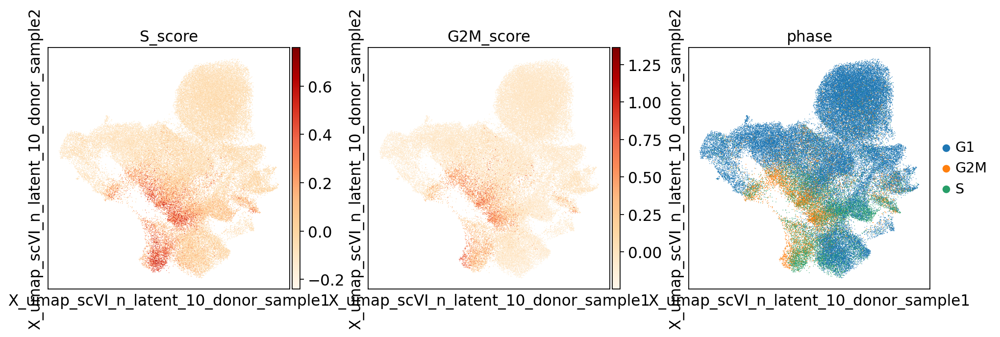

In [49]:
sc.pl.embedding(adata, curr_embedding_key,
                color=['S_score','G2M_score','phase'], cmap='OrRd')

In [50]:
adata

AnnData object with n_obs × n_vars = 74322 × 33538
    obs: 'n_genes', 'time_point', 'activation_status', 'media', 'sample', 'percent_mito', 'n_counts', 'dataset', 'technique', 'scrublet_score', 'scrublet_cluster_score', 'bh_pval', 'batch', 'is_doublet', 'experiment', 'barcode', 'souporcell_assignment', 'inter_ind_doublet', 'donor', 'prelim_annot_v2', 'S_score', 'G2M_score', 'phase', 'celltype_predictions_P13', 'probabilities_P13', 'celltype_predictions_Roser', 'probabilities_Roser', 'louvain', 'louvain_R', 'barcode_sample_copy', 'prelim_annot_v3', 'final_annot_v4', 'louvain_R_5', 'louvain_R_5,1', 'louvain_R_4', 'louvain_RR_4', 'louvain_final', 'louvain_RR_4_1', 'final_annot_v5', 'final_annot_v6', 'final_annot_v7', 'donor_sample', 'tissue_block', 'age', 'cell_type', 'annotation_prev', 'is_doublet_propagate', 'origin_M_F', 'annotation_prev_or_removed', 'inv_troph_labels_initial', 'louvain_scvi_n_latent_8', 'final_annot_inv_troph', 'louvain_scvi_troph_rest', 'final_annot_all_troph', 'fin

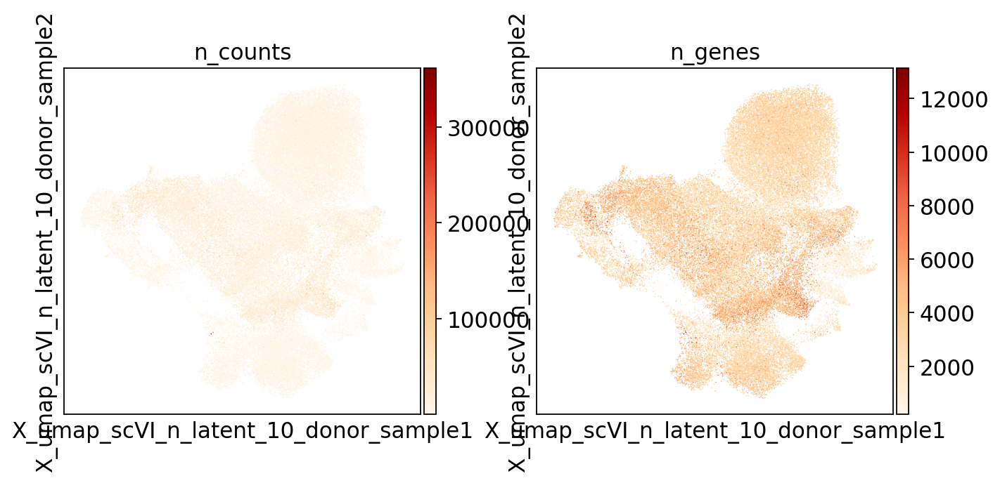

In [51]:
sc.pl.embedding(adata, curr_embedding_key, color=['n_counts',
                             'n_genes'], cmap='OrRd')

### scVI-corrected by `donor_sample`

n_latent = 15

In [52]:
curr_embedding_key = 'X_umap_scVI_n_latent_15_donor_sample'

In [57]:
adata

AnnData object with n_obs × n_vars = 74322 × 33538
    obs: 'n_genes', 'time_point', 'activation_status', 'media', 'sample', 'percent_mito', 'n_counts', 'dataset', 'technique', 'scrublet_score', 'scrublet_cluster_score', 'bh_pval', 'batch', 'is_doublet', 'experiment', 'barcode', 'souporcell_assignment', 'inter_ind_doublet', 'donor', 'prelim_annot_v2', 'S_score', 'G2M_score', 'phase', 'celltype_predictions_P13', 'probabilities_P13', 'celltype_predictions_Roser', 'probabilities_Roser', 'louvain', 'louvain_R', 'barcode_sample_copy', 'prelim_annot_v3', 'final_annot_v4', 'louvain_R_5', 'louvain_R_5,1', 'louvain_R_4', 'louvain_RR_4', 'louvain_final', 'louvain_RR_4_1', 'final_annot_v5', 'final_annot_v6', 'final_annot_v7', 'donor_sample', 'tissue_block', 'age', 'cell_type', 'annotation_prev', 'is_doublet_propagate', 'origin_M_F', 'annotation_prev_or_removed', 'inv_troph_labels_initial', 'louvain_scvi_n_latent_8', 'final_annot_inv_troph', 'louvain_scvi_troph_rest', 'final_annot_all_troph', 'fin

In [59]:
adata

AnnData object with n_obs × n_vars = 74322 × 33538
    obs: 'n_genes', 'time_point', 'activation_status', 'media', 'sample', 'percent_mito', 'n_counts', 'dataset', 'technique', 'scrublet_score', 'scrublet_cluster_score', 'bh_pval', 'batch', 'is_doublet', 'experiment', 'barcode', 'souporcell_assignment', 'inter_ind_doublet', 'donor', 'prelim_annot_v2', 'S_score', 'G2M_score', 'phase', 'celltype_predictions_P13', 'probabilities_P13', 'celltype_predictions_Roser', 'probabilities_Roser', 'louvain', 'louvain_R', 'barcode_sample_copy', 'prelim_annot_v3', 'final_annot_v4', 'louvain_R_5', 'louvain_R_5,1', 'louvain_R_4', 'louvain_RR_4', 'louvain_final', 'louvain_RR_4_1', 'final_annot_v5', 'final_annot_v6', 'final_annot_v7', 'donor_sample', 'tissue_block', 'age', 'cell_type', 'annotation_prev', 'is_doublet_propagate', 'origin_M_F', 'annotation_prev_or_removed', 'inv_troph_labels_initial', 'louvain_scvi_n_latent_8', 'final_annot_inv_troph', 'louvain_scvi_troph_rest', 'final_annot_all_troph', 'fin

### scVI-corrected by `donor_sample`

n_latent = 20

In [61]:
curr_embedding_key = 'X_umap_scVI_n_latent_20_donor_sample'

In [66]:
adata

AnnData object with n_obs × n_vars = 74322 × 33538
    obs: 'n_genes', 'time_point', 'activation_status', 'media', 'sample', 'percent_mito', 'n_counts', 'dataset', 'technique', 'scrublet_score', 'scrublet_cluster_score', 'bh_pval', 'batch', 'is_doublet', 'experiment', 'barcode', 'souporcell_assignment', 'inter_ind_doublet', 'donor', 'prelim_annot_v2', 'S_score', 'G2M_score', 'phase', 'celltype_predictions_P13', 'probabilities_P13', 'celltype_predictions_Roser', 'probabilities_Roser', 'louvain', 'louvain_R', 'barcode_sample_copy', 'prelim_annot_v3', 'final_annot_v4', 'louvain_R_5', 'louvain_R_5,1', 'louvain_R_4', 'louvain_RR_4', 'louvain_final', 'louvain_RR_4_1', 'final_annot_v5', 'final_annot_v6', 'final_annot_v7', 'donor_sample', 'tissue_block', 'age', 'cell_type', 'annotation_prev', 'is_doublet_propagate', 'origin_M_F', 'annotation_prev_or_removed', 'inv_troph_labels_initial', 'louvain_scvi_n_latent_8', 'final_annot_inv_troph', 'louvain_scvi_troph_rest', 'final_annot_all_troph', 'fin

In [68]:
adata

AnnData object with n_obs × n_vars = 74322 × 33538
    obs: 'n_genes', 'time_point', 'activation_status', 'media', 'sample', 'percent_mito', 'n_counts', 'dataset', 'technique', 'scrublet_score', 'scrublet_cluster_score', 'bh_pval', 'batch', 'is_doublet', 'experiment', 'barcode', 'souporcell_assignment', 'inter_ind_doublet', 'donor', 'prelim_annot_v2', 'S_score', 'G2M_score', 'phase', 'celltype_predictions_P13', 'probabilities_P13', 'celltype_predictions_Roser', 'probabilities_Roser', 'louvain', 'louvain_R', 'barcode_sample_copy', 'prelim_annot_v3', 'final_annot_v4', 'louvain_R_5', 'louvain_R_5,1', 'louvain_R_4', 'louvain_RR_4', 'louvain_final', 'louvain_RR_4_1', 'final_annot_v5', 'final_annot_v6', 'final_annot_v7', 'donor_sample', 'tissue_block', 'age', 'cell_type', 'annotation_prev', 'is_doublet_propagate', 'origin_M_F', 'annotation_prev_or_removed', 'inv_troph_labels_initial', 'louvain_scvi_n_latent_8', 'final_annot_inv_troph', 'louvain_scvi_troph_rest', 'final_annot_all_troph', 'fin

### scVI-corrected by `donor_sample`

n_latent = 30

In [ ]:
curr_embedding_key = 'X_umap_scVI_n_latent_30_donor_sample'

In [ ]:
sc.pl.embedding(adata, curr_embedding_key,
                color=['donor','dataset','cell_type','final_annot_v7'])

In [ ]:
sc.pl.embedding(adata, curr_embedding_key,
                color=['sample'])

In [ ]:
sc.pl.embedding(adata, curr_embedding_key,
                color=['HLA-G','HLA-C','PLAC8',
                             'ADAM8','ADAM19',
                            'NCAM1','ACTA2'], ncols=3, use_raw=True, cmap='OrRd')

In [ ]:
sc.pl.embedding(adata, curr_embedding_key, color=['CDK1','MKI67','CCNB2','PCNA'], cmap='OrRd')

In [ ]:
adata

In [ ]:
sc.pl.embedding(adata, curr_embedding_key,
                color=['S_score','G2M_score','phase'], cmap='OrRd')

In [ ]:
adata

In [ ]:
sc.pl.embedding(adata, curr_embedding_key, color=['n_counts',
                             'n_genes'], cmap='OrRd')

### scVI-corrected by `donor_sample`

n_latent = 40

In [ ]:
curr_embedding_key = 'X_umap_scVI_n_latent_40_donor_sample'

In [ ]:
sc.pl.embedding(adata, curr_embedding_key,
                color=['donor','dataset','cell_type','final_annot_v7'])

In [ ]:
sc.pl.embedding(adata, curr_embedding_key,
                color=['sample'])

In [ ]:
sc.pl.embedding(adata, curr_embedding_key,
                color=['HLA-G','HLA-C','PLAC8',
                             'ADAM8','ADAM19',
                            'NCAM1','ACTA2'], ncols=3, use_raw=True, cmap='OrRd')

In [ ]:
sc.pl.embedding(adata, curr_embedding_key, color=['CDK1','MKI67','CCNB2','PCNA'], cmap='OrRd')

In [ ]:
adata

In [ ]:
sc.pl.embedding(adata, curr_embedding_key,
                color=['S_score','G2M_score','phase'], cmap='OrRd')

In [ ]:
adata

In [ ]:
sc.pl.embedding(adata, curr_embedding_key, color=['n_counts',
                             'n_genes'], cmap='OrRd')

# Read in scVI-calculated latent representation

In [ ]:
# reading the previously saved file
# this is a common file with all scVI runs' manifold (corr by donor_sample OR dataset OR donor, not only corr by donor_sample like the name suggests)
adata = sc.read(save_path + 'adata_nonact_organoids_and_P13_sn_multiome_scVI_analysed_corr_by_donor_sample.h5ad')


In [ ]:
# a few values
n_latent = [5, 10, 15, 20, 30, 40]

### 06.01.2022 run, correction by `dataset` (in vivo P13 or in vitro)

In [ ]:
latent_representations_dataset = {}

# didn't align as well as corrected by donor_sample

for n_latent_value in n_latent:
    print(n_latent_value)
        
    curr_path = '/nfs/team292/aa22/scVI_related/202105_troph_organoids/20220106_obsm_with_scVI_latent_representation_n_' + str(n_latent_value) + '_steady_state_organoids_after_ccg_removal_and_LF_gf_and_donor_P13_after_ccg_removal_corr_by_dataset.csv' 
        
    latent_representations_dataset[n_latent_value] = pd.read_csv(curr_path, index_col=0)

In [ ]:
# assign these latent_representations into adata.obsm
for n_latent_value in n_latent:
    print(n_latent_value)
    adata.obsm['X_scVI_n_latent_' + str(n_latent_value) + '_dataset'] = np.array(latent_representations_dataset[n_latent_value])

In [ ]:
adata.obsm['X_scVI_n_latent_5_dataset'].shape

__________________________________________________________________________________________________________________________________________________________________

### Neighbourhood graph & UMAP

In [ ]:
%%time

for n_latent_value in n_latent:
    print(n_latent_value)
    sc.pp.neighbors(adata, n_neighbors=10, use_rep='X_scVI_n_latent_' + str(n_latent_value) + '_dataset',
               key_added='neighbors_scVI_n_latent_' + str(n_latent_value) + '_dataset' )

In [ ]:
adata

__________________________________________________________________________________________________________________________________________________________________

In [ ]:
%%time

for n_latent_value in n_latent:
    print(n_latent_value)

    sc.tl.umap(adata, random_state=0,
              neighbors_key='neighbors_scVI_n_latent_' + str(n_latent_value) + '_dataset')
    # copy current adata.obsm['X_umap'] into adata.obsm['X_umap_scVI_n_latent_' + str(n_latent_value)]
    adata.obsm['X_umap_scVI_n_latent_' + str(n_latent_value) + '_dataset'] = adata.obsm['X_umap']
    
    

In [ ]:
np.unique(adata.obs['sample'], return_counts=True)

In [ ]:
adata

## Saving this object with all the manifolds calculated

In [ ]:
adata.write(save_path + 'adata_nonact_organoids_and_P13_sn_multiome_scVI_analysed_corr_by_donor_sample.h5ad')


In [ ]:
# reading the previously saved file
# this is a common file with all scVI runs' manifold (corr by donor_sample OR dataset OR donor, not only corr by donor_sample like the name suggests)
adata = sc.read(save_path + 'adata_nonact_organoids_and_P13_sn_multiome_scVI_analysed_corr_by_donor_sample.h5ad')


In [ ]:
adata.obs.columns

In [ ]:
adata.obs['dataset'] = ['P13_in_vivo' if donor == 'P13' else 'in_vitro_orgs' for donor in adata.obs['donor']]
adata.obs['dataset'].value_counts()

### scVI-corrected by `dataset`

n_latent = 5

In [ ]:
curr_embedding_key = 'X_umap_scVI_n_latent_5_dataset'

In [ ]:
sc.pl.embedding(adata, curr_embedding_key,
                color=['donor','dataset','cell_type','final_annot_v7'])

In [ ]:
sc.pl.embedding(adata, curr_embedding_key,
                color=['dataset','donor','sample','cell_type','final_annot_v7'], ncols=3,
                wspace=0.4)

In [ ]:
sc.pl.embedding(adata, curr_embedding_key,
                color=['cell_type','final_annot_v7'], wspace=0.5)

In [ ]:
sc.pl.embedding(adata, curr_embedding_key,
                color=['sample'])

In [ ]:
sc.pl.embedding(adata, curr_embedding_key,
                color=['HLA-G','HLA-C','PLAC8',
                             'ADAM8','ADAM19',
                            'NCAM1','ACTA2'], ncols=3, use_raw=True, cmap='OrRd')

In [ ]:
sc.pl.embedding(adata, curr_embedding_key, color=['CDK1','MKI67','CCNB2','PCNA'], cmap='OrRd')

In [ ]:
adata

In [ ]:
sc.pl.embedding(adata, curr_embedding_key,
                color=['S_score','G2M_score','phase'], cmap='OrRd')

In [ ]:
adata

In [ ]:
sc.pl.embedding(adata, curr_embedding_key, color=['n_counts',
                             'n_genes'], cmap='OrRd')

### scVI-corrected by `dataset`

n_latent = 10

In [ ]:
curr_embedding_key = 'X_umap_scVI_n_latent_10_dataset'

In [ ]:
sc.pl.embedding(adata, curr_embedding_key,
                color=['donor','dataset','cell_type','final_annot_v7'])

In [ ]:
sc.pl.embedding(adata, curr_embedding_key,
                color=['sample'])

In [ ]:
sc.pl.embedding(adata, curr_embedding_key,
                color=['HLA-G','HLA-C','PLAC8',
                             'ADAM8','ADAM19',
                            'NCAM1','ACTA2'], ncols=3, use_raw=True, cmap='OrRd')

In [ ]:
sc.pl.embedding(adata, curr_embedding_key, color=['CDK1','MKI67','CCNB2','PCNA'], cmap='OrRd')

In [ ]:
adata

In [ ]:
sc.pl.embedding(adata, curr_embedding_key,
                color=['S_score','G2M_score','phase'], cmap='OrRd')

In [ ]:
adata

In [ ]:
sc.pl.embedding(adata, curr_embedding_key, color=['n_counts',
                             'n_genes'], cmap='OrRd')

### scVI-corrected by `dataset`

n_latent = 15

In [ ]:
curr_embedding_key = 'X_umap_scVI_n_latent_15_dataset'

In [ ]:
sc.pl.embedding(adata, curr_embedding_key,
                color=['donor','dataset','cell_type','final_annot_v7'])

In [ ]:
sc.pl.embedding(adata, curr_embedding_key,
                color=['sample'])

In [ ]:
sc.pl.embedding(adata, curr_embedding_key,
                color=['donor_sample'])

In [ ]:
sc.pl.embedding(adata, curr_embedding_key,
                color=['HLA-G','HLA-C','PLAC8',
                             'ADAM8','ADAM19',
                            'NCAM1','ACTA2'], ncols=3, use_raw=True, cmap='OrRd')

In [ ]:
sc.pl.embedding(adata, curr_embedding_key, color=['CDK1','MKI67','CCNB2','PCNA'], cmap='OrRd')

In [ ]:
adata

In [ ]:
sc.pl.embedding(adata, curr_embedding_key,
                color=['S_score','G2M_score','phase'], cmap='OrRd')

In [ ]:
adata

In [ ]:
sc.pl.embedding(adata, curr_embedding_key, color=['n_counts',
                             'n_genes'], cmap='OrRd')

### scVI-corrected by `dataset`

n_latent = 20

In [ ]:
curr_embedding_key = 'X_umap_scVI_n_latent_20_dataset'

In [ ]:
sc.pl.embedding(adata, curr_embedding_key,
                color=['donor','dataset','cell_type','final_annot_v7'])

In [ ]:
sc.pl.embedding(adata, curr_embedding_key,
                color=['sample'])

In [ ]:
sc.pl.embedding(adata, curr_embedding_key,
                color=['HLA-G','HLA-C','PLAC8',
                             'ADAM8','ADAM19',
                            'NCAM1','ACTA2'], ncols=3, use_raw=True, cmap='OrRd')

In [ ]:
sc.pl.embedding(adata, curr_embedding_key, color=['CDK1','MKI67','CCNB2','PCNA'], cmap='OrRd')

In [ ]:
adata

In [ ]:
sc.pl.embedding(adata, curr_embedding_key,
                color=['S_score','G2M_score','phase'], cmap='OrRd')

In [ ]:
adata

In [ ]:
sc.pl.embedding(adata, curr_embedding_key, color=['n_counts',
                             'n_genes'], cmap='OrRd')

### scVI-corrected by `dataset`

n_latent = 30

In [ ]:
curr_embedding_key = 'X_umap_scVI_n_latent_30_dataset'

In [ ]:
sc.pl.embedding(adata, curr_embedding_key,
                color=['donor','dataset','cell_type','final_annot_v7'])

In [ ]:
sc.pl.embedding(adata, curr_embedding_key,
                color=['sample'])

In [ ]:
sc.pl.embedding(adata, curr_embedding_key,
                color=['HLA-G','HLA-C','PLAC8',
                             'ADAM8','ADAM19',
                            'NCAM1','ACTA2'], ncols=3, use_raw=True, cmap='OrRd')

In [ ]:
sc.pl.embedding(adata, curr_embedding_key, color=['CDK1','MKI67','CCNB2','PCNA'], cmap='OrRd')

In [ ]:
adata

In [ ]:
sc.pl.embedding(adata, curr_embedding_key,
                color=['S_score','G2M_score','phase'], cmap='OrRd')

In [ ]:
adata

In [ ]:
sc.pl.embedding(adata, curr_embedding_key, color=['n_counts',
                             'n_genes'], cmap='OrRd')

### scVI-corrected by `dataset`

n_latent = 40

In [ ]:
curr_embedding_key = 'X_umap_scVI_n_latent_40_dataset'

In [ ]:
sc.pl.embedding(adata, curr_embedding_key,
                color=['donor','dataset','cell_type','final_annot_v7'])

In [ ]:
sc.pl.embedding(adata, curr_embedding_key,
                color=['sample'])

In [ ]:
sc.pl.embedding(adata, curr_embedding_key,
                color=['HLA-G','HLA-C','PLAC8',
                             'ADAM8','ADAM19',
                            'NCAM1','ACTA2'], ncols=3, use_raw=True, cmap='OrRd')

In [ ]:
sc.pl.embedding(adata, curr_embedding_key, color=['CDK1','MKI67','CCNB2','PCNA'], cmap='OrRd')

In [ ]:
adata

In [ ]:
sc.pl.embedding(adata, curr_embedding_key,
                color=['S_score','G2M_score','phase'], cmap='OrRd')

In [ ]:
adata

In [ ]:
sc.pl.embedding(adata, curr_embedding_key, color=['n_counts',
                             'n_genes'], cmap='OrRd')

# Read in scVI-calculated latent representation

In [ ]:
# reading the previously saved file
# this is a common file with all scVI runs' manifold (corr by donor_sample OR dataset OR donor, not only corr by donor_sample like the name suggests)
adata = sc.read(save_path + 'adata_nonact_organoids_and_P13_sn_multiome_scVI_analysed_corr_by_donor_sample.h5ad')


In [ ]:
# a few values
n_latent = [5, 10, 15, 20, 30, 40]

### 06.01.2022 run, correction by `donor` (in vivo P13 or in vitro donors 1-6)

In [ ]:
latent_representations_donor = {}

# didn't align as well as corrected by donor_sample

for n_latent_value in n_latent:
    print(n_latent_value)
        
    curr_path = '/nfs/team292/aa22/scVI_related/202105_troph_organoids/20220106_obsm_with_scVI_latent_representation_n_' + str(n_latent_value) + '_steady_state_organoids_after_ccg_removal_and_LF_gf_and_donor_P13_after_ccg_removal_corr_by_donor.csv' 
        
    latent_representations_donor[n_latent_value] = pd.read_csv(curr_path, index_col=0)
    

In [ ]:
# assign these latent_representations into adata.obsm
for n_latent_value in n_latent:
    print(n_latent_value)
    adata.obsm['X_scVI_n_latent_' + str(n_latent_value) + '_donor'] = np.array(latent_representations_donor[n_latent_value])

In [ ]:
adata.obsm['X_scVI_n_latent_5_donor'].shape

__________________________________________________________________________________________________________________________________________________________________

### Neighbourhood graph & UMAP

In [ ]:
%%time

for n_latent_value in n_latent:
    print(n_latent_value)
    sc.pp.neighbors(adata, n_neighbors=10, use_rep='X_scVI_n_latent_' + str(n_latent_value) + '_donor',
               key_added='neighbors_scVI_n_latent_' + str(n_latent_value) + '_donor' )

In [ ]:
adata

__________________________________________________________________________________________________________________________________________________________________

In [ ]:
%%time

for n_latent_value in n_latent:
    print(n_latent_value)

    sc.tl.umap(adata, random_state=0,
              neighbors_key='neighbors_scVI_n_latent_' + str(n_latent_value) + '_donor')
    # copy current adata.obsm['X_umap'] into adata.obsm['X_umap_scVI_n_latent_' + str(n_latent_value)]
    adata.obsm['X_umap_scVI_n_latent_' + str(n_latent_value) + '_donor'] = adata.obsm['X_umap']
    
    

In [ ]:
np.unique(adata.obs['sample'], return_counts=True)

In [ ]:
adata

## Saving this object with all the manifolds calculated

In [ ]:
adata.write(save_path + 'adata_nonact_organoids_and_P13_sn_multiome_scVI_analysed_corr_by_donor_sample.h5ad')


In [ ]:
# reading the previously saved file
# this is a common file with all scVI runs' manifold (corr by donor_sample OR dataset OR donor, not only corr by donor_sample like the name suggests)
adata = sc.read(save_path + 'adata_nonact_organoids_and_P13_sn_multiome_scVI_analysed_corr_by_donor_sample.h5ad')


In [ ]:
adata.obs.columns

In [ ]:
adata.obs['dataset'] = ['P13_in_vivo' if donor == 'P13' else 'in_vitro_orgs' for donor in adata.obs['donor']]
adata.obs['dataset'].value_counts()

### scVI-corrected by `donor`

n_latent = 5

In [ ]:
curr_embedding_key = 'X_umap_scVI_n_latent_5_donor'

In [ ]:
sc.pl.embedding(adata, curr_embedding_key,
                color=['donor','dataset','cell_type','final_annot_v7'])

In [ ]:
sc.pl.embedding(adata, curr_embedding_key,
                color=['dataset','donor','sample','cell_type','final_annot_v7'], ncols=3,
                wspace=0.4)

In [ ]:
sc.pl.embedding(adata, curr_embedding_key,
                color=['sample'])

In [ ]:
sc.pl.embedding(adata, curr_embedding_key,
                color=['HLA-G','HLA-C','PLAC8',
                             'ADAM8','ADAM19',
                            'NCAM1','ACTA2'], ncols=3, use_raw=True, cmap='OrRd')

In [ ]:
sc.pl.embedding(adata, curr_embedding_key, color=['CDK1','MKI67','CCNB2','PCNA'], cmap='OrRd')

In [ ]:
adata

In [ ]:
sc.pl.embedding(adata, curr_embedding_key,
                color=['S_score','G2M_score','phase'], cmap='OrRd')

In [ ]:
adata

In [ ]:
sc.pl.embedding(adata, curr_embedding_key, color=['n_counts',
                             'n_genes'], cmap='OrRd')

### scVI-corrected by `donor`

n_latent = 10

In [ ]:
curr_embedding_key = 'X_umap_scVI_n_latent_10_donor'

In [ ]:
sc.pl.embedding(adata, curr_embedding_key,
                color=['donor','dataset','cell_type','final_annot_v7'])

In [ ]:
sc.pl.embedding(adata, curr_embedding_key,
                color=['sample'])

In [ ]:
sc.pl.embedding(adata, curr_embedding_key,
                color=['HLA-G','HLA-C','PLAC8',
                             'ADAM8','ADAM19',
                            'NCAM1','ACTA2'], ncols=3, use_raw=True, cmap='OrRd')

In [ ]:
sc.pl.embedding(adata, curr_embedding_key, color=['CDK1','MKI67','CCNB2','PCNA'], cmap='OrRd')

In [ ]:
adata

In [ ]:
sc.pl.embedding(adata, curr_embedding_key,
                color=['S_score','G2M_score','phase'], cmap='OrRd')

In [ ]:
adata

In [ ]:
sc.pl.embedding(adata, curr_embedding_key, color=['n_counts',
                             'n_genes'], cmap='OrRd')

### scVI-corrected by `donor`

n_latent = 15

In [ ]:
curr_embedding_key = 'X_umap_scVI_n_latent_15_donor'

In [ ]:
sc.pl.embedding(adata, curr_embedding_key,
                color=['donor','dataset','cell_type','final_annot_v7'])

In [ ]:
sc.pl.embedding(adata, curr_embedding_key,
                color=['sample'])

In [ ]:
sc.pl.embedding(adata, curr_embedding_key,
                color=['donor_sample'])

In [ ]:
sc.pl.embedding(adata, curr_embedding_key,
                color=['HLA-G','HLA-C','PLAC8',
                             'ADAM8','ADAM19',
                            'NCAM1','ACTA2'], ncols=3, use_raw=True, cmap='OrRd')

In [ ]:
sc.pl.embedding(adata, curr_embedding_key, color=['CDK1','MKI67','CCNB2','PCNA'], cmap='OrRd')

In [ ]:
adata

In [ ]:
sc.pl.embedding(adata, curr_embedding_key,
                color=['S_score','G2M_score','phase'], cmap='OrRd')

In [ ]:
adata

In [ ]:
sc.pl.embedding(adata, curr_embedding_key, color=['n_counts',
                             'n_genes'], cmap='OrRd')

### scVI-corrected by `donor`

n_latent = 20

In [ ]:
curr_embedding_key = 'X_umap_scVI_n_latent_20_donor'

In [ ]:
sc.pl.embedding(adata, curr_embedding_key,
                color=['donor','dataset','cell_type','final_annot_v7'])

In [ ]:
sc.pl.embedding(adata, curr_embedding_key,
                color=['sample'])

In [ ]:
sc.pl.embedding(adata, curr_embedding_key,
                color=['HLA-G','HLA-C','PLAC8',
                             'ADAM8','ADAM19',
                            'NCAM1','ACTA2'], ncols=3, use_raw=True, cmap='OrRd')

In [ ]:
sc.pl.embedding(adata, curr_embedding_key, color=['CDK1','MKI67','CCNB2','PCNA'], cmap='OrRd')

In [ ]:
adata

In [ ]:
sc.pl.embedding(adata, curr_embedding_key,
                color=['S_score','G2M_score','phase'], cmap='OrRd')

In [ ]:
adata

In [ ]:
sc.pl.embedding(adata, curr_embedding_key, color=['n_counts',
                             'n_genes'], cmap='OrRd')

### scVI-corrected by `donor`

n_latent = 30

In [ ]:
curr_embedding_key = 'X_umap_scVI_n_latent_30_donor'

In [ ]:
sc.pl.embedding(adata, curr_embedding_key,
                color=['donor','dataset','cell_type','final_annot_v7'])

In [ ]:
sc.pl.embedding(adata, curr_embedding_key,
                color=['sample'])

In [ ]:
sc.pl.embedding(adata, curr_embedding_key,
                color=['HLA-G','HLA-C','PLAC8',
                             'ADAM8','ADAM19',
                            'NCAM1','ACTA2'], ncols=3, use_raw=True, cmap='OrRd')

In [ ]:
sc.pl.embedding(adata, curr_embedding_key, color=['CDK1','MKI67','CCNB2','PCNA'], cmap='OrRd')

In [ ]:
adata

In [ ]:
sc.pl.embedding(adata, curr_embedding_key,
                color=['S_score','G2M_score','phase'], cmap='OrRd')

In [ ]:
adata

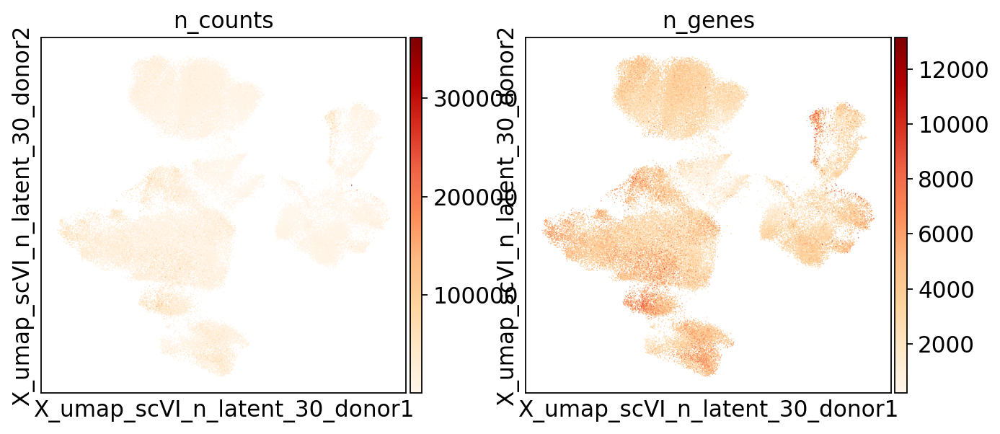

In [63]:
sc.pl.embedding(adata, curr_embedding_key, color=['n_counts',
                             'n_genes'], cmap='OrRd')

### scVI-corrected by `donor`

n_latent = 40

In [64]:
curr_embedding_key = 'X_umap_scVI_n_latent_40_donor'

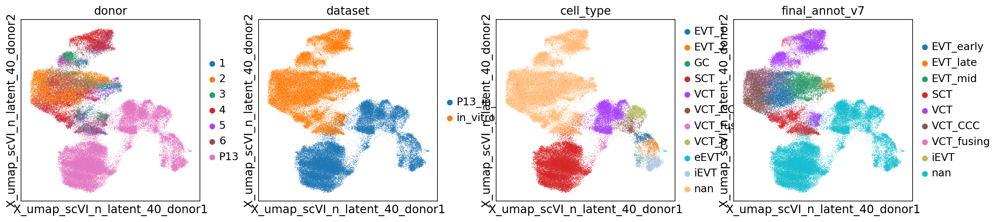

In [65]:
sc.pl.embedding(adata, curr_embedding_key,
                color=['donor','dataset','cell_type','final_annot_v7'])

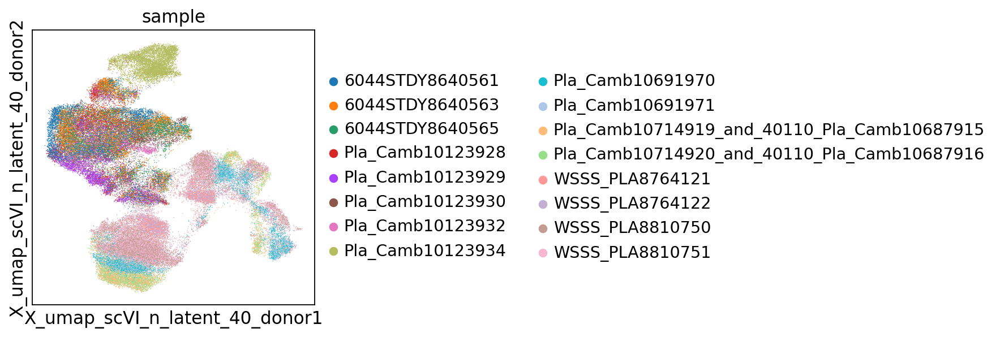

In [66]:
sc.pl.embedding(adata, curr_embedding_key,
                color=['sample'])

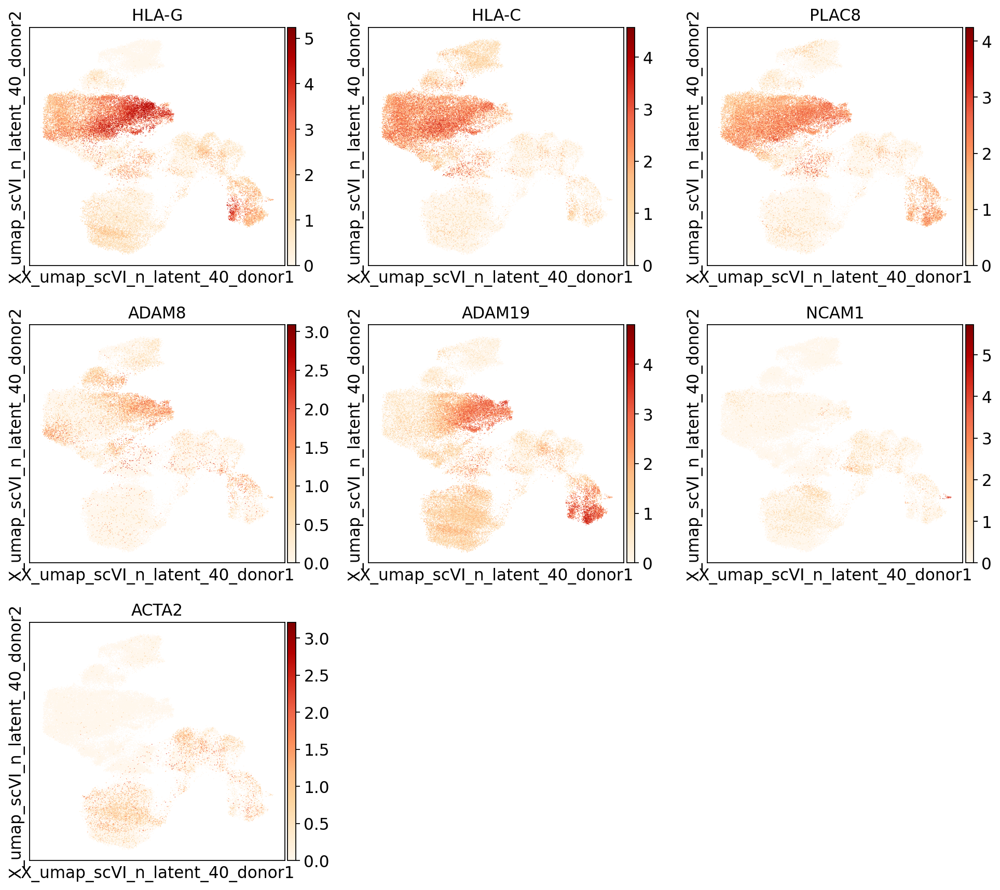

In [67]:
sc.pl.embedding(adata, curr_embedding_key,
                color=['HLA-G','HLA-C','PLAC8',
                             'ADAM8','ADAM19',
                            'NCAM1','ACTA2'], ncols=3, use_raw=True, cmap='OrRd')

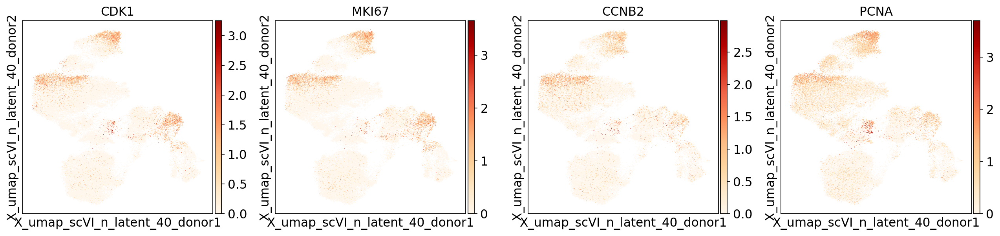

In [68]:
sc.pl.embedding(adata, curr_embedding_key, color=['CDK1','MKI67','CCNB2','PCNA'], cmap='OrRd')

In [69]:
adata

AnnData object with n_obs × n_vars = 74322 × 33538
    obs: 'n_genes', 'time_point', 'activation_status', 'media', 'sample', 'percent_mito', 'n_counts', 'dataset', 'technique', 'scrublet_score', 'scrublet_cluster_score', 'bh_pval', 'batch', 'is_doublet', 'experiment', 'barcode', 'souporcell_assignment', 'inter_ind_doublet', 'donor', 'prelim_annot_v2', 'S_score', 'G2M_score', 'phase', 'celltype_predictions_P13', 'probabilities_P13', 'celltype_predictions_Roser', 'probabilities_Roser', 'louvain', 'louvain_R', 'barcode_sample_copy', 'prelim_annot_v3', 'final_annot_v4', 'louvain_R_5', 'louvain_R_5,1', 'louvain_R_4', 'louvain_RR_4', 'louvain_final', 'louvain_RR_4_1', 'final_annot_v5', 'final_annot_v6', 'final_annot_v7', 'donor_sample', 'tissue_block', 'age', 'cell_type', 'annotation_prev', 'is_doublet_propagate', 'origin_M_F', 'annotation_prev_or_removed', 'inv_troph_labels_initial', 'louvain_scvi_n_latent_8', 'final_annot_inv_troph', 'louvain_scvi_troph_rest', 'final_annot_all_troph', 'fin

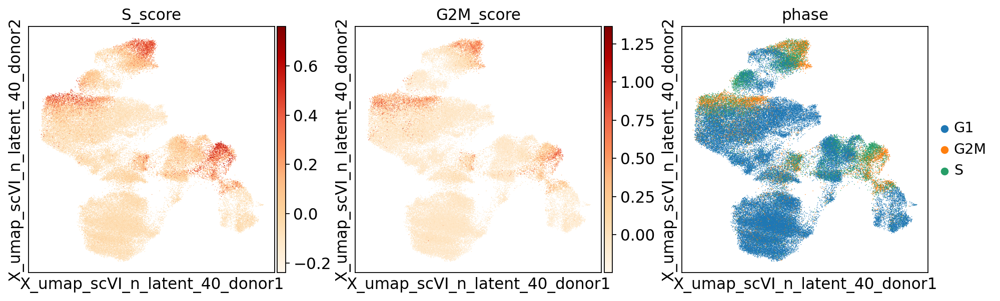

In [70]:
sc.pl.embedding(adata, curr_embedding_key,
                color=['S_score','G2M_score','phase'], cmap='OrRd')

In [71]:
adata

AnnData object with n_obs × n_vars = 74322 × 33538
    obs: 'n_genes', 'time_point', 'activation_status', 'media', 'sample', 'percent_mito', 'n_counts', 'dataset', 'technique', 'scrublet_score', 'scrublet_cluster_score', 'bh_pval', 'batch', 'is_doublet', 'experiment', 'barcode', 'souporcell_assignment', 'inter_ind_doublet', 'donor', 'prelim_annot_v2', 'S_score', 'G2M_score', 'phase', 'celltype_predictions_P13', 'probabilities_P13', 'celltype_predictions_Roser', 'probabilities_Roser', 'louvain', 'louvain_R', 'barcode_sample_copy', 'prelim_annot_v3', 'final_annot_v4', 'louvain_R_5', 'louvain_R_5,1', 'louvain_R_4', 'louvain_RR_4', 'louvain_final', 'louvain_RR_4_1', 'final_annot_v5', 'final_annot_v6', 'final_annot_v7', 'donor_sample', 'tissue_block', 'age', 'cell_type', 'annotation_prev', 'is_doublet_propagate', 'origin_M_F', 'annotation_prev_or_removed', 'inv_troph_labels_initial', 'louvain_scvi_n_latent_8', 'final_annot_inv_troph', 'louvain_scvi_troph_rest', 'final_annot_all_troph', 'fin

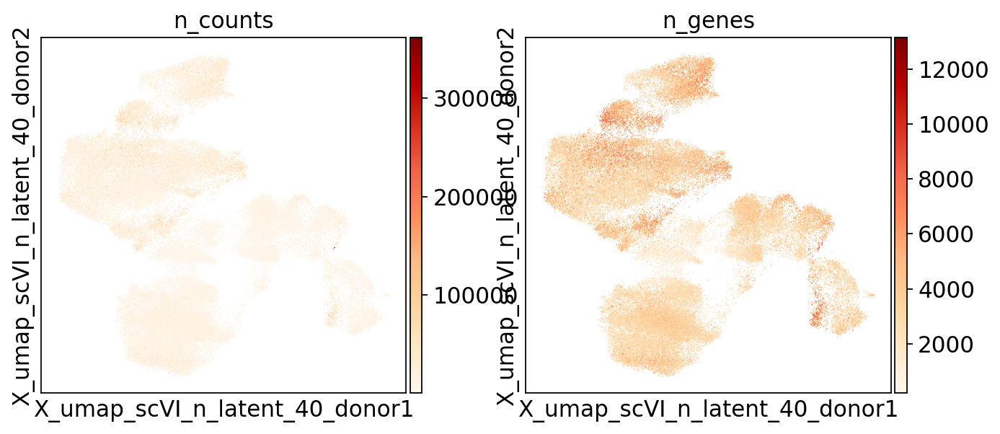

In [72]:
sc.pl.embedding(adata, curr_embedding_key, color=['n_counts',
                             'n_genes'], cmap='OrRd')